In [ ]:
!pip install -r requirements.txt

In [ ]:
%tensorflow_version 1.13.1

In [ ]:
from google.colab import files
files.upload()


Saving kaggle (2).json to kaggle (2).json


{'kaggle (2).json': b'{"username":"maozragab","key":"8f9ceffe771258045eafff79b324f732"}'}

In [ ]:
!kaggle datasets download -d tthien/shanghaitech

 97% 324M/333M [00:05<00:00, 85.4MB/s]
100% 333M/333M [00:05<00:00, 63.8MB/s]


In [ ]:


!mkdir -p ~/.kaggle
!cp kaggle.json ~/.kaggle/
!chmod 600 ~/.kaggle/kaggle.json


In [ ]:
from zipfile import ZipFile
file_name="shanghaitech.zip"
with ZipFile(file_name,'r') as zip:
  zip.extractall()
  print("ok")

ok


In [ ]:
from zipfile import ZipFile
file_name="MCNN_in_Keras-master.zip"
with ZipFile(file_name,'r') as zip:
  zip.extractall()
  print("ok")

ok


In [ ]:
import os
import cv2
import csv
import argparse
from scipy.io import loadmat
import gen_density_map




In [ ]:
dataset = 'A'
path = '/content/ShanghaiTech/part_A/test_data/images/'
gt_path = '/content/ShanghaiTech/part_A/test_data/ground_truth/'
gt_path_csv = '/content/ShanghaiTech/part_A/test_data/ground_truth_csv/'

if not os.path.exists(gt_path_csv):
    os.makedirs(gt_path_csv)
if dataset == 'A':
    num_images = 182
else:
    num_images = 316


In [ ]:
print(image_info['image_info'])

In [ ]:
x=''.join((gt_path,'GT_IMG_1', '.mat'))
print(x)

/content/ShanghaiTech/part_A/test_data/ground_truth/GT_IMG_1.mat


In [ ]:
import os
import csv
import cv2
import math
import random
from scipy.io import loadmat
import gen_density_map
import argparse


seed = 123456
random.seed(seed)
dataset = 'A'
N = 9  
dataset_name = ''.join(['shanghaitech_part_', dataset, '_patches_', str(N)])
path = ''.join(['shanghaitech/part_', dataset, '/train_data/images/'])
output_path = 'data/formatted_trainval_{}/'.format(dataset)
train_path_img = ''.join((output_path, dataset_name, '/train/'))
train_path_den = ''.join((output_path, dataset_name, '/train_den/'))
val_path_img = ''.join((output_path, dataset_name, '/val/'))
val_path_den = ''.join((output_path, dataset_name, '/val_den/'))
gt_path = ''.join(['shanghaitech/part_', dataset, '/train_data/ground_truth/'])
print(gt_path)



shanghaitech/part_A/train_data/ground_truth/


In [ ]:

for i in [output_path, train_path_img, train_path_den, val_path_img, val_path_den]:
    if not os.path.exists(i):
        os.makedirs(i)


In [ ]:

if dataset == 'A':
    num_images =  300
else:
    num_images = 400

num_val = math.ceil(num_images * 0.1)  
indices = list(range(1, num_images + 1))
random.shuffle(indices)

for idx in range(num_images):


    i = indices[idx]
    if (idx+1) % 10 == 0:
        print('Processing {}/{} files'.format(idx+1, num_images))
    
    input_img_name = ''.join((path, 'IMG_', str(i), '.jpg'))
    if os.path.isfile(input_img_name):

      im = cv2.imread(input_img_name, 0)
      
      image_info = loadmat(''.join((gt_path, 'GT_IMG_', str(i), '.mat')))['image_info']
      annPoints = image_info[0][0][0][0][0] - 1
      
      im_density = gen_density_map.gen_density_map(im, annPoints)

      h, w = im.shape
      wn2, hn2 = w / 8, h / 8  
      wn2, hn2 = int(wn2 / 8) * 8, int(hn2 / 8) * 8  
      
      xmin, xmax = wn2, w - wn2
      ymin, ymax = hn2, h - hn2
      
      for j in range(1, N + 1):
          
          x = math.floor((xmax - xmin) * random.random() + xmin)
          y = math.floor((ymax - ymin) * random.random() + ymin)
          
          x1, y1 = x - wn2, y - hn2
          x2, y2 = x + wn2, y + hn2
          
          im_sampled = im[y1:y2, x1:x2]
          im_density_sampled = im_density[y1:y2, x1:x2]

          
          img_idx = ''.join((str(i), '_', str(j)))
          path_img, path_den = (val_path_img, val_path_den) if (idx+1) < num_val else (train_path_img, train_path_den)
          cv2.imwrite(''.join([path_img, img_idx, '.jpg']), im_sampled)
          with open(''.join([path_den, img_idx, '.csv']), 'w', newline='') as fout:
              writer = csv.writer(fout)
              writer.writerows(im_density_sampled)


Processing 10/300 files
Processing 20/300 files
Processing 30/300 files
Processing 40/300 files
Processing 50/300 files
Processing 60/300 files
Processing 70/300 files
Processing 80/300 files
Processing 90/300 files
Processing 100/300 files
Processing 110/300 files
Processing 120/300 files
Processing 130/300 files
Processing 140/300 files
Processing 150/300 files
Processing 160/300 files
Processing 170/300 files
Processing 180/300 files
Processing 190/300 files
Processing 200/300 files
Processing 210/300 files
Processing 220/300 files
Processing 230/300 files
Processing 240/300 files
Processing 250/300 files
Processing 260/300 files
Processing 270/300 files
Processing 280/300 files
Processing 290/300 files
Processing 300/300 files


In [ ]:
import numpy as np

seed = 123456
random.seed(seed)
dataset = 'A'
N = 9  
dataset_name = ''.join(['shanghaitech_part_', dataset, '_patches_', str(N)])
path = '/content/ShanghaiTech/part_A/train_data/images/'
output_path = 'data/formatted_trainval_{}/'.format(dataset)
train_path_img = ''.join((output_path, dataset_name, '/train/'))
train_path_den = ''.join((output_path, dataset_name, '/train_den/'))
val_path_img = ''.join((output_path, dataset_name, '/val/'))
val_path_den = ''.join((output_path, dataset_name, '/val_den/'))
gt_path = '/content/ShanghaiTech/part_A/train_data/ground-truth/'
print(gt_path)

for i in [output_path, train_path_img, train_path_den, val_path_img, val_path_den]:
    if not os.path.exists(i):
        os.makedirs(i)

if dataset == 'A':
    num_images = 300
else:
    num_images = 400

num_val = math.ceil(num_images * 0.1) 
indices = list(range(1, num_images + 1))
random.shuffle(indices)

for idx in range(num_images):

  i = indices[idx]
  if (idx+1) % 10 == 0:
      print('Processing {}/{} files'.format(idx+1, num_images))
  
  input_img_name = ''.join((path, 'IMG_', str(i), '.jpg'))
  im = cv2.imread(input_img_name, 0)
  
  x11=''.join((gt_path, 'GT_IMG_', str(i), '.mat'))

  image_info = loadmat(''.join((gt_path, 'GT_IMG_', str(i), '.mat')))['image_info']
  annPoints = image_info[0][0][0][0][0] - 1
 

  density_map = np.zeros_like(im, dtype=np.float64)
  print(density_map.shape)
  
  im_density = gen_density_map.gen_density_map(im, annPoints)
  
  h, w = im.shape
  wn2, hn2 = w / 8, h / 8  
  wn2, hn2 = int(wn2 / 8) * 8, int(hn2 / 8) * 8 
  xmin, xmax = wn2, w - wn2
  ymin, ymax = hn2, h - hn2
  for j in range(1, N + 1):
      x = math.floor((xmax - xmin) * random.random() + xmin)
      y = math.floor((ymax - ymin) * random.random() + ymin)
      x1, y1 = x - wn2, y - hn2
      x2, y2 = x + wn2, y + hn2
     
      im_sampled = im[y1:y2, x1:x2]
      im_density_sampled = im_density[y1:y2, x1:x2]

      # 保存
      img_idx = ''.join((str(i), '_', str(j)))
      path_img, path_den = (val_path_img, val_path_den) if (idx+1) < num_val else (train_path_img, train_path_den)
      cv2.imwrite(''.join([path_img, img_idx, '.jpg']), im_sampled)
      with open(''.join([path_den, img_idx, '.csv']), 'w', newline='') as fout:
          writer = csv.writer(fout)
          writer.writerows(im_density_sampled)
         


/content/ShanghaiTech/part_A/train_data/ground-truth/
(686, 1024)
(688, 1024)
(667, 1000)
(619, 1024)
(564, 832)
(667, 1000)
(694, 1024)
(293, 442)
(469, 709)
Processing 10/300 files
(683, 1024)
(386, 509)
(728, 1024)
(388, 690)
(716, 1024)
(661, 817)
(683, 1024)
(506, 487)
(450, 299)
(692, 1024)
Processing 20/300 files
(640, 640)
(342, 1018)
(680, 1024)
(688, 1024)
(373, 561)
(688, 1024)
(522, 1024)
(768, 1024)
(576, 1024)
(768, 1024)
Processing 30/300 files
(768, 1024)
(681, 1024)
(768, 1024)
(768, 1024)
(561, 1024)
(590, 1024)
(662, 962)
(605, 1024)
(684, 1024)
(768, 1024)
Processing 40/300 files
(596, 1024)
(390, 600)
(411, 443)
(768, 1024)
(683, 1024)
(768, 1024)
(649, 1024)
(665, 1024)
(768, 1024)
(656, 1024)
Processing 50/300 files
(685, 1024)
(768, 1024)
(681, 1024)
(274, 939)
(462, 650)
(768, 1024)
(746, 1024)
(639, 1024)
(530, 800)
(579, 840)
Processing 60/300 files
(370, 545)
(617, 1024)
(280, 692)
(649, 800)
(774, 1024)
(512, 1024)
(565, 849)
(768, 1024)
(681, 1024)
(455, 6

In [ ]:
from keras.optimizers import Adam
from keras.callbacks import ModelCheckpoint
from model import MCNN
from utils.data_loader import DataLoader
from utils.metrics import mae, mse
import config as cfg
import os
import argparse
from keras.models import Sequential




In [ ]:


                                     #traning
train_path = '/content/data/formatted_trainval_A/shanghaitech_part_A_patches_9/train/'
train_gt_path = '/content/data/formatted_trainval_A/shanghaitech_part_A_patches_9/train_den/'
val_path = '/content/data/formatted_trainval_A/shanghaitech_part_A_patches_9/val/'
val_gt_path = '/content/data/formatted_trainval_A/shanghaitech_part_A_patches_9/val_den/'

print('Loading data, wait a moment...')
train_data_gen = DataLoader(train_path, train_gt_path, shuffle=True, gt_downsample=True)
val_data_gen = DataLoader(val_path, val_gt_path, shuffle=False, gt_downsample=True)


input_shape = (None, None, 1)
model = MCNN(input_shape)

adam = Adam(lr=1e-4)
model.compile(loss='mse', optimizer=adam, metrics=[mae, mse])


###############################///حفظ*********************************************

checkpointer_best_train = ModelCheckpoint(
    filepath='final_model2.h5',
    monitor='loss', verbose=1, save_best_only=True, mode='min'
)

callback_list = [checkpointer_best_train]


print('Training Part_{} ...'.format(dataset))

model.fit_generator(train_data_gen.flow(cfg.TRAIN_BATCH_SIZE),
                    steps_per_epoch=train_data_gen.num_samples // cfg.TRAIN_BATCH_SIZE,
                    validation_data=val_data_gen.flow(cfg.VAL_BATCH_SIZE),
                    validation_steps=val_data_gen.num_samples // cfg.VAL_BATCH_SIZE,
                    epochs=cfg.EPOCHS,
                    callbacks=callback_list,
                    verbose=1)




Loading data, wait a moment...
Training Part_A ...
Epoch 1/200


ValueError: ignored

In [ ]:
#model.save('/content/drive/My Drive/tech_variable/final_model2.h5')

In [ ]:
print('done......')

In [ ]:
#                 -*deployment -*-
from keras.optimizers import Adam
from keras.callbacks import ModelCheckpoint
from model import MCNN
from utils.data_loader import DataLoader
from utils.metrics import mae, mse
import config as cfg
import os
import argparse
from pyheatmap.heatmap import HeatMap

from keras.models import load_model
from keras.preprocessing.image import load_img

import numpy as np
import cv2
import os
import pandas as pd
#pip install pyheatmap

Testing Part_A ...


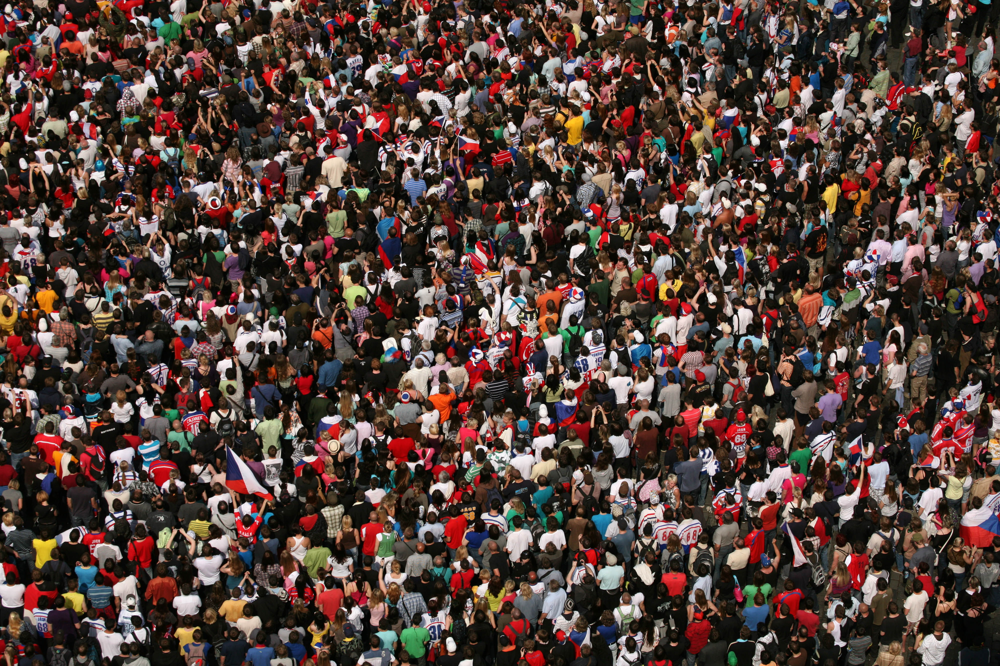

3113


In [ ]:

pic='/content/6SMFWFTGOESH2VBC2U3WVVSLN4 (1).jpg'

img = cv2.imread(pic, 0)

img = img.astype(np.float32, copy=False)

ht = img.shape[0]
wd = img.shape[1]
ht_1 = int((ht / 4) * 4)
wd_1 = int((wd / 4) * 4)
img2 = cv2.resize(img, (wd_1, ht_1))
img = img.reshape((img.shape[0], img.shape[1], 1))


#print(img2)


model_path = '/content/MCNN_in_Keras-master/trained_models/mcnn_A_train.hdf5'

model = load_model(model_path)

# test
print('Testing Part_{} ...'.format(dataset))
mae = 0.0
mse = 0.0


pred = model.predict(np.expand_dims(img, axis=0))

# create and save heatmap
pred = np.squeeze(pred) #shape(1, h, w, 1) -> shape(h, w)
#save_heatmap(pred, img, test_path, '/content/ShanghaiTech/part_A/heatmaps')
# save results
counts = int(np.sum(pred))  



d = load_img(pic)

display(d)
print(counts)







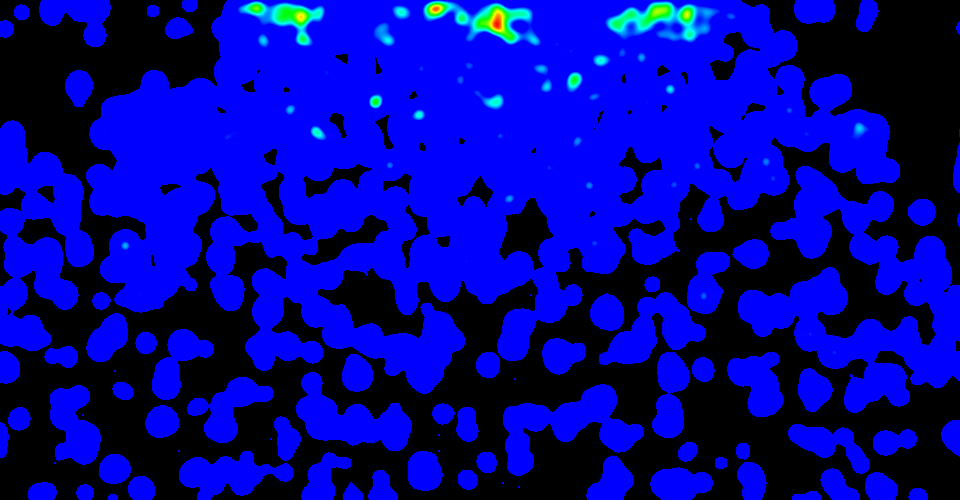

585


In [ ]:



down_sample=True
if down_sample:
    den_resized = np.zeros((pred.shape[0] * 4, pred.shape[1] * 4))
    for i in range(den_resized.shape[0]):
        for j in range(den_resized.shape[1]):
            den_resized[i][j] = pred[int(i / 4)][int(j / 4)] / 16
    pred = den_resized

h, w = img.shape[:2]
pred = pred * 1000
data = []
for row in range(h):
    for col in range(w):
        try:
            for k in range(int(pred[row][col])):
                data.append([col + 1, row + 1])
        except IndexError:
            continue

hm = HeatMap(data, width=w, height=h)

hm_name = 'heatmap_'+"img_name".split('.')[0]+'.png'
hm.heatmap(save_as=os.path.join('/content/ShanghaiTech/part_A/heatmaps', hm_name))

img = load_img('/content/ShanghaiTech/part_A/heatmaps/heatmap_img_name.png')

display(img)
print(counts)